In [1]:
import sys
sys.path.append('../../')
from panav.environment.env import Room, MultiTunnelEnv, WareHouse
from panav.viz import draw_env,draw_hybrid
from panav.hybrid import HybridGraph

from time import time
import pickle as pkl

%load_ext autoreload
%autoreload 2

In [2]:
def get_env_name(filename):
    fs = filename.split('.')
    return fs[0]

In [85]:
from panav.sequential import sequential_HybridSIPP, sequential_planning
from panav.SAMP.solvers import Tube_Planning
from benchmarks.ST_RRTStar_wrapper import sequential_ST_RRTStar 
from os import listdir

bloating_r = 0.5
vmax = 1.0

TIMEOUT = 200

# Specify the Algorithms
algs = {  
        'HybridSIPP':lambda HG: sequential_HybridSIPP(HG,Kmax = 8,Delta=3.0,return_on_failure=True),
        # 'SIPP':lambda HG: sequential_HybridSIPP(HG,Kmax = 0),
        "Seq_Tube": lambda HG: sequential_planning(Tube_Planning,HG.env,vmax,bloating_r,TIMEOUT=TIMEOUT), 
        # "ST-RRT*": lambda HG: sequential_ST_RRTStar(HG.env,vmax,bloating_r)     
        }
# Load environment presets
env_names = [get_env_name(fn) for fn in listdir('./envs')]

env_infos = {}

for name in env_names:
    with open(f'./envs/{name}.pkl','rb') as fp:
        env_infos[name] = pkl.load(fp)

In [81]:
import numpy as np
env_name = 'Warehouse'
SEED = 13981
np.random.seed(SEED)  # Fix the random seed
N = 20


env_info = env_infos[env_name]
constructor = env_info['constructor']
specs = env_info['specs']

print('Building the environment...')
HG = constructor(**specs,N_agent = N)

Building the environment...


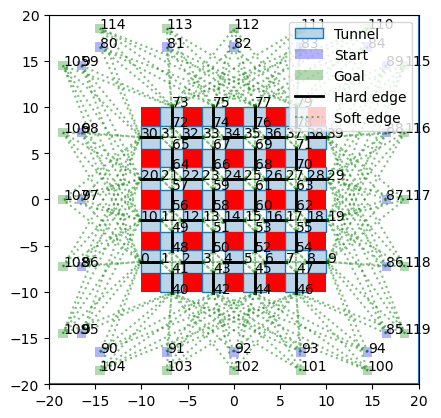

In [82]:

draw_hybrid(HG,display_soft=True)

In [86]:
alg_name = 'HybridSIPP'
alg = algs[alg_name]
plans = alg(HG)

0
Km= 0
Solve time 0.04673194885253906
1
Km= 0
Solve time 0.039868831634521484
2
Km= 0
Solve time 0.039121150970458984
3
Km= 0
Solve time 0.04444289207458496
4
Km= 0
Solve time 0.04902911186218262
5
Km= 0
Solve time 0.048751115798950195
6
Km= 0
Solve time 0.04916572570800781
7
Km= 0
Solve time 0.04952502250671387
8
Km= 0
Km= 1


/Users/tianpengzhang/opt/miniconda3/envs/PA-NAV/lib/python3.11/site-packages/cvxpy/problems/problem.py:1391: UserWarning: 
    The problem is either infeasible or unbounded, but the solver
    cannot tell which. Disable any solver-specific presolve methods
    and re-solve to determine the precise problem status.

    For GUROBI and CPLEX you can automatically perform this re-solve
    with the keyword argument prob.solve(reoptimize=True, ...).
    
  warnings.warn(INF_OR_UNB_MESSAGE)


Solve time 2.286851167678833
9
Km= 0
Solve time 0.05649280548095703
10
Km= 0
Solve time 0.08839297294616699
11
Km= 0
Solve time 0.06871414184570312
12
Km= 0
Solve time 0.09649419784545898
13
Km= 0
Solve time 0.07299470901489258
14
Km= 0
Km= 1
Km= 2
Solve time 6.4924421310424805
15
Km= 0
Km= 1
Km= 2
Solve time 6.1458799839019775
16
Km= 0
Solve time 0.06760716438293457
17
Km= 0
Km= 1
Km= 2
Solve time 10.834439277648926
18
Km= 0
Solve time 0.06436800956726074
19
Km= 0
Km= 1
Km= 2
Solve time 4.002190113067627


In [84]:
from matplotlib import pyplot as plt
from panav.viz import animation
from IPython.display import HTML, display
from matplotlib import rcParams
from panav.util import interpolate_positions

exec_tau = 0.25

rcParams['animation.embed_limit'] = 2**128
dt = exec_tau 
agents = range(len(plans))
pos_to_ani = []

for cp in plans:
    _,xs = interpolate_positions(*cp,dt)
    pos_to_ani.append(xs)
    
anim = animation(HG.env, pos_to_ani, bloating_r, dt = dt)
display(HTML(anim.to_jshtml()))
plt.close() 

In [68]:
import numpy as np
env_name = 'SingleTunnel'
SEED = 13981
np.random.seed(SEED)  # Fix the random seed
N = 20


env_info = env_infos[env_name]
constructor = env_info['constructor']
specs = env_info['specs']

print('Building the environment...')
HG = constructor(**specs,N_agent = N)

Building the environment...


/Users/tianpengzhang/opt/miniconda3/envs/PA-NAV/lib/python3.11/site-packages/shapely/measurement.py:74: RuntimeWarning: invalid value encountered in distance
  return lib.distance(a, b, **kwargs)
/Users/tianpengzhang/opt/miniconda3/envs/PA-NAV/lib/python3.11/site-packages/shapely/predicates.py:798: RuntimeWarning: invalid value encountered in intersects
  return lib.intersects(a, b, **kwargs)


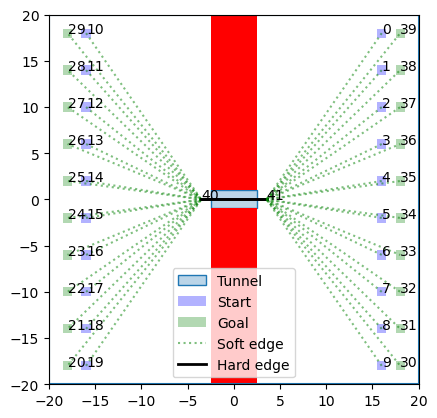

In [69]:

draw_hybrid(HG,display_soft=True)

In [73]:
alg_name = 'HybridSIPP'
alg = algs[alg_name]
plans = alg(HG)

0
Km= 0
Solve time 0.01008296012878418
1
Km= 0
Solve time 0.007028818130493164
2
Km= 0
Solve time 0.00694727897644043
3
Km= 0
Solve time 0.006318092346191406
4
Km= 0
Solve time 0.006751060485839844
5
Km= 0
Solve time 0.007825136184692383
6
Km= 0
Solve time 0.006124973297119141
7
Km= 0
Solve time 0.006884098052978516
8
Km= 0
Solve time 0.0061931610107421875
9
Km= 0
Solve time 0.00657200813293457
10
Km= 0
Km= 1
Km= 2
Solve time 0.1782851219177246
11
Km= 0
Km= 1
Km= 2
Solve time 0.16812682151794434
12
Km= 0
Km= 1
Km= 2
Solve time 0.433474063873291
13
Km= 0
Km= 1
Km= 2
Solve time 0.46515703201293945
14
Km= 0
Km= 1
Km= 2
Km= 3
Solve time 0.9531199932098389
15
Km= 0
Km= 1
Km= 2
Km= 3
Solve time 0.5073659420013428
16
Km= 0
Km= 1
Km= 2
Km= 3
Solve time 0.3452417850494385
17
Km= 0
Km= 1
Km= 2
Km= 3
Solve time 0.48218607902526855
18
Km= 0
Km= 1
Km= 2
Km= 3
Km= 4
Solve time 0.7402808666229248
19
Km= 0
Km= 1
Km= 2
Km= 3
Solve time 0.3128325939178467


In [74]:
from matplotlib import pyplot as plt
from panav.viz import animation
from IPython.display import HTML, display
from matplotlib import rcParams
from panav.util import interpolate_positions

exec_tau = 0.25

rcParams['animation.embed_limit'] = 2**128
dt = exec_tau 
agents = range(len(plans))
pos_to_ani = []

for cp in plans:
    _,xs = interpolate_positions(*cp,dt)
    pos_to_ani.append(xs)
    
anim = animation(HG.env, pos_to_ani, bloating_r, dt = dt)
display(HTML(anim.to_jshtml()))
plt.close() 